In [142]:
import pandas as pd
import scipy as sc
import matplotlib.pyplot as plt
import numpy as np


In [143]:
#Read in Knife Data
KnifeData = pd.read_csv("/Users/MedoYounes/Desktop/CUSP London Data Dive 2019/data/Knife crime data/WardLevelKnifeCrime.csv")
KnifeData.head()

,Ward Code,Ward Name,Borough Code,Borough Name,Date - Daily Data,Knife Crime Offs,Knife Crime With Injury Offs,Knife Crime with Injury Pers Robb Offs,Knife Crime Injury Victims 1-24,Knife Crime Injury Victims Not DA 1-24 Gang Flagged,Knife Crime Injury Victims Not DA 1-24,Gun Crime Lethal Barrelled Discharged Offs
0,E05000026,Abbey,KG,Barking and Dagenham,01 Jan 2018,0,0,0,0,0,0,0
1,E05000026,Abbey,KG,Barking and Dagenham,02 Jan 2018,1,0,0,0,0,0,0
2,E05000026,Abbey,KG,Barking and Dagenham,03 Jan 2018,0,0,0,0,0,0,0
3,E05000026,Abbey,KG,Barking and Dagenham,04 Jan 2018,0,0,0,0,0,0,0
4,E05000026,Abbey,KG,Barking and Dagenham,05 Jan 2018,0,0,0,0,0,0,0


In [145]:
KnifeData = KnifeData.rename(columns={'Date - Daily Data': 'Date', 'Borough Name': 'Borough'}, inplace = False)
KnifeData['Date'] = pd.to_datetime(KnifeData['Date'])


 #KnifeData.groupby(['Borough Name', 'Date']).sum()
BoroughAgg = KnifeData.groupby(['Borough', "Borough Code"],as_index = True).resample('M', on = 'Date').sum()


BoroughAgg

Knife Crime Offs  \
Borough              Borough Code Date                           
Barking and Dagenham KG           2018-01-31                23   
                                  2018-02-28                28   
                                  2018-03-31                30   
                                  2018-04-30                26   
                                  2018-05-31                29   
                                  2018-06-30                41   
                                  2018-07-31                37   
                                  2018-08-31                42   
                                  2018-09-30                27   
                                  2018-10-31                29   
                                  2018-11-30                31   
                                  2018-12-31                33   
Barnet               SX           2018-01-31                32   
                                  2018-02-28                18   
                                  2018-03-31                42   
                                  2018-04-30                27   
                                  2018-05-31                39   
                                  2018-06-30                40   
                                  2018-07-31                26   
                                  2018-08-31                33   
                                  2018-09-30                25   
                                  2018-10-31                30   
                                  2018-11-30                28   
                                  2018-12-31                28   
Bexley               RY           2018-01-31                15   
                                  2018-02-28                18   
                                  2018-03-31                18   
                                  2018-04-30                17   
                                  2018-05-31                14   
                                  2018-06-30                30   
...                                                        ...   
Waltham Forest       JC           2018-07-31                48   
                                  2018-08-31                35   
                                  2018-09-30                21   
                                  2018-10-31                44   
                                  2018-11-30                40   
                                  2018-12-31                27   
Wandsworth           WW           2018-01-31                28   
                                  2018-02-28                30   
                                  2018-03-31                43   
                                  2018-04-30                40   
                                  2018-05-31                25   
                                  2018-06-30                50   
                                  2018-07-31                55   
                                  2018-08-31                33   
                                  2018-09-30                23   
                                  2018-10-31                33   
                                  2018-11-30                48   
                                  2018-12-31                23   
Westminster          CW           2018-01-31                70   
                                  2018-02-28                46   
                                  2018-03-31                57   
                                  2018-04-30                62   
                                  2018-05-31                62   
                                  2018-06-30                59   
                                  2018-07-31                76   
                                  2018-08-31                99   
                                  2018-09-30                64   
                                  2018-10-31                78   
                    

In [7]:
BoroughAgg.to_csv('BoroughAgg.csv')

In [8]:
WardAgg = KnifeData.groupby(['Ward Name', 'Ward Code'], as_index = True).resample('M', on = "Date").sum()

WardAgg

Knife Crime Offs  \
Ward Name               Ward Code  Date                           
Abbey                   E05000026  2018-01-31                 5   
                                   2018-02-28                 2   
                                   2018-03-31                 4   
                                   2018-04-30                 2   
                                   2018-05-31                 2   
                                   2018-06-30                 8   
                                   2018-07-31                 6   
                                   2018-08-31                 8   
                                   2018-09-30                 3   
                                   2018-10-31                 7   
                                   2018-11-30                 3   
                                   2018-12-31                 4   
                        E05000455  2018-01-31                 1   
                                   2018-02-28                 2   
                                   2018-03-31                 0   
                                   2018-04-30                 0   
                                   2018-05-31                 1   
                                   2018-06-30                 0   
                                   2018-07-31                 0   
                                   2018-08-31                 0   
                                   2018-09-30                 0   
                                   2018-10-31                 1   
                                   2018-11-30                 1   
                                   2018-12-31                 0   
Abbey Road              E05000630  2018-01-31                 2   
                                   2018-02-28                 1   
                                   2018-03-31                 3   
                                   2018-04-30                 1   
                                   2018-05-31                 1   
                                   2018-06-30                 1   
...                                                         ...   
Wormholt and White City E05000265  2018-07-31                 0   
                                   2018-08-31                 2   
                                   2018-09-30                 4   
                                   2018-10-31                 2   
                                   2018-11-30                 5   
                                   2018-12-31                 2   
Yeading                 E05000344  2018-01-31                 3   
                                   2018-02-28                 0   
                                   2018-03-31                 2   
                                   2018-04-30                 1   
                                   2018-05-31                 0   
                                   2018-06-30                 0   
                                   2018-07-31                 3   
                                   2018-08-31                 0   
                                   2018-09-30                 0   
                                   2018-10-31                 0   
                                   2018-11-30                 0   
                                   2018-12-31                 0   
Yiewsley                E05000345  2018-01-31                 1   
                                   2018-02-28                 2   
                                   2018-03-31                 1   
                                   2018-04-30                 0   
                                   2018-05-31                 3   
                                   2018-06-30                 0   
                                   2018-07-31                 2   
                                   2018-08-31                 3   
                                   2018-09-30                 3   
                           

In [9]:
WardAgg.to_csv('WardAgg.csv')

In [17]:
BoroughAgg = pd.read_csv('BoroughAgg.csv')
WardAgg = pd.read_csv('WardAgg.csv')
WardAgg

,Ward Name,Ward Code,Date,Knife Crime Offs,Knife Crime With Injury Offs,Knife Crime with Injury Pers Robb Offs,Knife Crime Injury Victims 1-24,Knife Crime Injury Victims Not DA 1-24 Gang Flagged,Knife Crime Injury Victims Not DA 1-24,Gun Crime Lethal Barrelled Discharged Offs
0,Abbey,E05000026,2018-01-31,5,1,0,1,0,1,0
1,Abbey,E05000026,2018-02-28,2,1,0,0,0,0,0
2,Abbey,E05000026,2018-03-31,4,1,0,0,0,0,0
3,Abbey,E05000026,2018-04-30,2,0,0,0,0,0,0
4,Abbey,E05000026,2018-05-31,2,1,1,0,0,0,0
5,Abbey,E05000026,2018-06-30,8,0,0,0,0,0,0
6,Abbey,E05000026,2018-07-31,6,4,0,2,0,2,0
7,Abbey,E05000026,2018-08-31,8,4,1,1,0,1,0
8,Abbey,E05000026,2018-09-30,3,2,0,3,0,3,0
9,Abbey,E05000026,2018-10-31,7,2,2,1,0,1,0


In [22]:
WardAgg['Knife_Total'] = WardAgg.iloc[:, -7:-1].sum(axis=1)
WardAgg
WardAgg.to_csv('WardAgg_Monthly.csv')

In [12]:
#Combining Daily Knife Crime Columns into one 
Daily_Knife_Gun = KnifeData.groupby(['Ward Name', 'Ward Code'], as_index = True).resample('D', on = 'Date').sum()
Daily_Knife_Gun.to_csv('Daily_Knife_Gun.csv')
DailyKnife = pd.read_csv('Daily_Knife_Gun.csv')

In [13]:
DailyKnife['Knife_Total'] = DailyKnife.iloc[:,-8:-2].sum(axis = 1)
DailyKnife.to_csv('Daily_Knife_Gun.csv')

In [14]:
#DailyKnife = DailyKnife.set_index('Ward Code')
DailyKnife

,Ward Name,Ward Code,Date,Knife Crime Offs,Knife Crime With Injury Offs,Knife Crime with Injury Pers Robb Offs,Knife Crime Injury Victims 1-24,Knife Crime Injury Victims Not DA 1-24 Gang Flagged,Knife Crime Injury Victims Not DA 1-24,Gun Crime Lethal Barrelled Discharged Offs,Knife_Total
0,Abbey,E05000026,2018-01-01,0,0,0,0,0,0,0,0
1,Abbey,E05000026,2018-01-02,1,0,0,0,0,0,0,1
2,Abbey,E05000026,2018-01-03,0,0,0,0,0,0,0,0
3,Abbey,E05000026,2018-01-04,0,0,0,0,0,0,0,0
4,Abbey,E05000026,2018-01-05,0,0,0,0,0,0,0,0
5,Abbey,E05000026,2018-01-06,0,0,0,0,0,0,0,0
6,Abbey,E05000026,2018-01-07,0,0,0,0,0,0,0,0
7,Abbey,E05000026,2018-01-08,0,0,0,0,0,0,0,0
8,Abbey,E05000026,2018-01-09,0,0,0,0,0,0,0,0
9,Abbey,E05000026,2018-01-10,0,0,0,0,0,0,0,0


In [15]:
plt.style.use('seaborn-darkgrid')
palette = plt.get_cmap('Set1')



DailyKnife.loc['E05000026'].plot(x = 'Date', y = 'Knife_Total')
plt.ylabel('Total Knife Crimes')
plt.xlabel('Time - Daily')
plt.title('Abbey')

KeyError: 'the label [E05000026] is not in the [index]'

In [ ]:
DailyKnife['Ward Name'] = 

/Users/MedoYounes/anaconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


KeyboardInterrupt: 

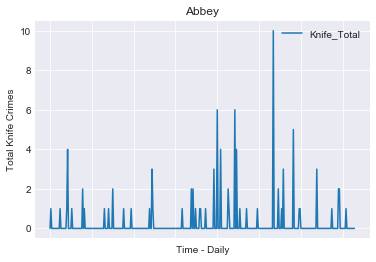

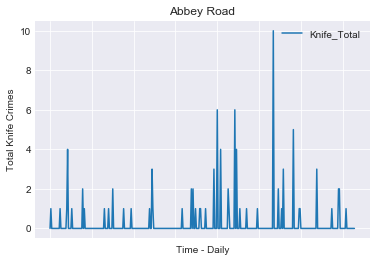

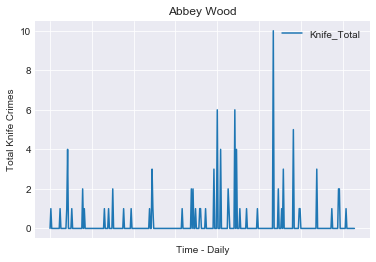

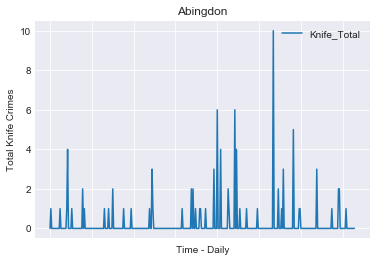

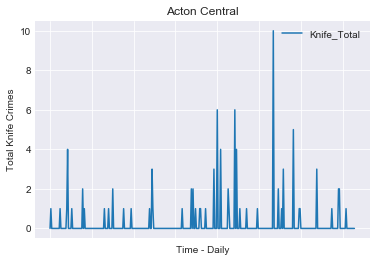

...

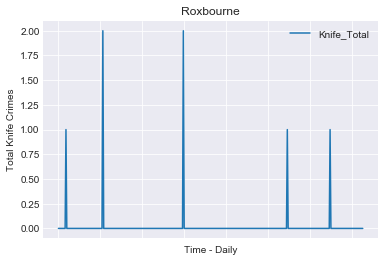

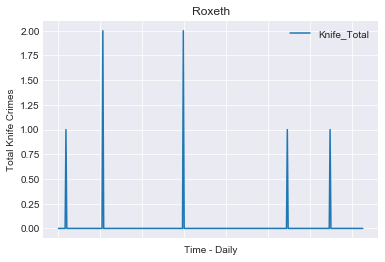

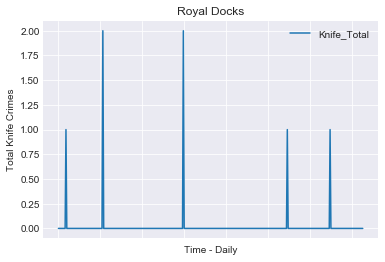

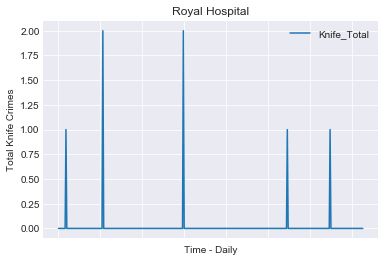

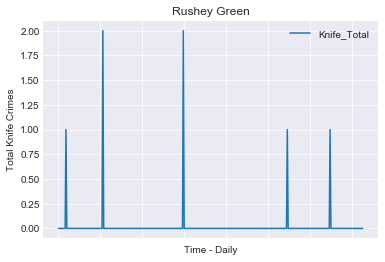

In [ ]:
for i in WardCodes:
    
    for j in WardNames:
    
        DailyKnife.loc[i].plot(x = 'Date', y = 'Knife_Total')
        plt.ylabel('Total Knife Crimes')
        plt.xlabel('Time - Daily')
        plt.title(j)

In [121]:
#Generating Line PLots of Daily Knife Crimes Throughout the Wards
#Get Unique List of Ward Codes and Names to iterate through for line plots 
WardNames = DailyKnife['Ward Name'].unique()


WardCodes = WardAgg['Ward Code'].unique()
WardNames

array(['Abbey', 'Abbey Road', 'Abbey Wood', 'Abingdon', 'Acton Central',
       'Addiscombe', 'Addison', 'Aldborough', 'Aldersgate', 'Aldgate',
       'Alexandra', 'Alibon', 'Alperton', 'Ashburton', 'Askew',
       'Avonmore and Brook Green', 'Balham', 'Barkingside', 'Barnehurst',
       'Barnes', 'Barnhill', 'Barnsbury', 'Bassishaw', 'Bayswater',
       'Beckton', 'Becontree', 'Beddington North', 'Beddington South',
       'Bedfont', 'Bedford', 'Bellingham', 'Belmont', 'Belsize',
       'Belvedere', 'Bensham Manor', 'Berrylands', 'Bethnal Green',
       'Beverley', 'Bickley', 'Biggin Hill', 'Billingsgate', "Bishop's",
       'Bishopsgate', 'Blackfen and Lamorbey', 'Blackheath',
       'Blackheath Westcombe', 'Blackwall and Cubitt Town',
       'Blendon and Penhill', 'Bloomsbury', 'Boleyn', 'Botwell',
       'Bounds Green', 'Bow East', 'Bow West', 'Bowes', 'Brampton',
       'Bread Street', 'Brentford', 'Bridge', 'Brixton Hill',
       'Broad Green', 'Broad Street', 'Brockley',
       

In [122]:
#Combining Ward Population with Knife Crimes

WardProf = pd.read_csv('/Users/MedoYounes/Desktop/CUSP London Data Dive 2019/data/Knife crime data/Ward_Profile.csv')
WardProf.rename(columns = {'New code':'Ward Code'}, inplace = True)
WardProf.set_index('Ward Code')

#pd.to_numeric(WardProf['Population'])
WardProf

,Ward name,Ward Code,Population
0,City of London,E09000001,"8,100"
1,Barking and Dagenham - Abbey,E05000026,"14,750"
2,Barking and Dagenham - Alibon,E05000027,"10,600"
3,Barking and Dagenham - Becontree,E05000028,"12,700"
4,Barking and Dagenham - Chadwell Heath,E05000029,"10,400"
5,Barking and Dagenham - Eastbrook,E05000030,"10,750"
6,Barking and Dagenham - Eastbury,E05000031,"11,900"
7,Barking and Dagenham - Gascoigne,E05000032,"15,850"
8,Barking and Dagenham - Goresbrook,E05000033,"11,450"
9,Barking and Dagenham - Heath,E05000034,"11,150"


In [150]:
WardAnnual = KnifeData.groupby(['Ward Name', 'Ward Code', 'Borough']).resample('Y', on = 'Date').sum()

WardAnnual.to_csv("WardAnnual.csv")
#WardAnnual = pd.read_csv("WardAnnual.csv")
WardAnnual

Knife Crime Offs  \
Ward Name                Ward Code  Borough                Date                           
Abbey                    E05000026  Barking and Dagenham   2018-12-31                54   
                         E05000455  Merton                 2018-12-31                 6   
Abbey Road               E05000630  Westminster            2018-12-31                26   
Abbey Wood               E05000214  Greenwich              2018-12-31                26   
Abingdon                 E05009388  Kensington and Chelsea 2018-12-31                11   
Acton Central            E05000170  Ealing                 2018-12-31                21   
Addiscombe               E05000146  Croydon                2018-12-31                18   
Addison                  E05000250  Hammersmith and Fulham 2018-12-31                20   
Aldborough               E05000495  Redbridge              2018-12-31                18   
Aldersgate               E05009288  City of London         2018-12-31                 0   
Aldgate                  E05009289  City of London         2018-12-31                 0   
Alexandra                E05000266  Haringey               2018-12-31                28   
                         E05000400  Kingston upon Thames   2018-12-31                 1   
Alibon                   E05000027  Barking and Dagenham   2018-12-31                18   
Alperton                 E05000085  Brent                  2018-12-31                18   
Ashburton                E05000147  Croydon                2018-12-31                25   
Askew                    E05000251  Hammersmith and Fulham 2018-12-31                15   
Avonmore and Brook Green E05000252  Hammersmith and Fulham 2018-12-31                 7   
Balham                   E05000610  Wandsworth             2018-12-31                11   
Barkingside              E05000496  Redbridge              2018-12-31                22   
Barnehurst               E05000064  Bexley                 2018-12-31                 6   
Barnes                   E05000516  Richmond upon Thames   2018-12-31                 6   
Barnhill                 E05000086  Brent                  2018-12-31                 6   
                         E05000324  Hillingdon             2018-12-31                25   
Barnsbury                E05000366  Islington              2018-12-31                36   
Bassishaw                E05009290  City of London         2018-12-31                 0   
Bayswater                E05000631  Westminster            2018-12-31                19   
Beckton                  E05000475  Newham                 2018-12-31                34   
Becontree                E05000028  Barking and Dagenham   2018-12-31                21   
Beddington North         E05000555  Sutton                 2018-12-31                 8   
...                                                                                 ...   
West Hampstead           E05000145  Camden                 2018-12-31                25   
West Harrow              E05000305  Harrow                 2018-12-31                 8   
West Hendon              E05000062  Barnet                 2018-12-31                17   
West Hill                E05000628  Wandsworth             2018-12-31                 9   
West Putney              E05000629  Wandsworth             2018-12-31                15   
West Ruislip             E05000343  Hillingdon             2018-12-31                 5   
West Thornton            E05000168  Croydon                2018-12-31                23   
West Twickenham          E05000532  Richmond upon Thames   2018-12-31                 7   
West Wickham             E05000127  Bromley                2018-12-31                 0   
Westbourne               E05000648  Westminster            2018-12-31                51   
Whalebone                E05000042  Barking and Dagenham   2018-12-31                22   
White Hart Lane          E05000283  Haringey               2018-12-

In [139]:
WardAnnual['Knife_Total'] = WardAnnual.iloc[:,-8:-2].sum(axis = 1)
WardAnnual

,Ward Name,Ward Code,Date,Knife Crime Offs,Knife Crime With Injury Offs,Knife Crime with Injury Pers Robb Offs,Knife Crime Injury Victims 1-24,Knife Crime Injury Victims Not DA 1-24 Gang Flagged,Knife Crime Injury Victims Not DA 1-24,Gun Crime Lethal Barrelled Discharged Offs,Knife_Total
0,Abbey,E05000026,2018-12-31,54,18,4,8,0,8,0,92
1,Abbey,E05000455,2018-12-31,6,1,0,0,0,0,2,7
2,Abbey Road,E05000630,2018-12-31,26,2,0,0,0,0,1,28
3,Abbey Wood,E05000214,2018-12-31,26,11,1,8,0,7,2,53
4,Abingdon,E05009388,2018-12-31,11,5,1,2,0,2,0,21
5,Acton Central,E05000170,2018-12-31,21,8,0,2,0,2,0,33
6,Addiscombe,E05000146,2018-12-31,18,6,0,4,2,4,0,34
7,Addison,E05000250,2018-12-31,20,5,0,0,0,0,0,25
8,Aldborough,E05000495,2018-12-31,18,6,2,4,0,4,2,34
9,Aldersgate,E05009288,2018-12-31,0,0,0,0,0,0,0,0


In [140]:
WardPopAnn = WardAnnual.merge(WardProf, left_on = 'Ward Code', right_on = 'Ward Code')

WardPopAnn['Population'] = WardPopAnn['Population'].apply(lambda x: int(str(x).replace(',','')))
WardPopAnn['Knife_Person'] = (WardPopAnn['Knife_Total']/WardPopAnn['Population'])*1000
WardPopAnn

,Ward Name,Ward Code,Date,Knife Crime Offs,Knife Crime With Injury Offs,Knife Crime with Injury Pers Robb Offs,Knife Crime Injury Victims 1-24,Knife Crime Injury Victims Not DA 1-24 Gang Flagged,Knife Crime Injury Victims Not DA 1-24,Gun Crime Lethal Barrelled Discharged Offs,Knife_Total,Ward name,Population,Knife_Person
0,Abbey,E05000026,2018-12-31,54,18,4,8,0,8,0,92,Barking and Dagenham - Abbey,14750,6.237288
1,Abbey,E05000455,2018-12-31,6,1,0,0,0,0,2,7,Merton - Abbey,10600,0.660377
2,Abbey Road,E05000630,2018-12-31,26,2,0,0,0,0,1,28,Westminster - Abbey Road,11500,2.434783
3,Abbey Wood,E05000214,2018-12-31,26,11,1,8,0,7,2,53,Greenwich - Abbey Wood,16200,3.271605
4,Acton Central,E05000170,2018-12-31,21,8,0,2,0,2,0,33,Ealing - Acton Central,15850,2.082019
5,Addiscombe,E05000146,2018-12-31,18,6,0,4,2,4,0,34,Croydon - Addiscombe,17750,1.915493
6,Aldborough,E05000495,2018-12-31,18,6,2,4,0,4,2,34,Redbridge - Aldborough,15800,2.151899
7,Alibon,E05000027,2018-12-31,18,5,0,3,0,2,0,28,Barking and Dagenham - Alibon,10600,2.641509
8,Alperton,E05000085,2018-12-31,18,7,2,2,0,2,0,31,Brent - Alperton,15300,2.026144
9,Ashburton,E05000147,2018-12-31,25,3,0,3,0,3,0,34,Croydon - Ashburton,15150,2.244224


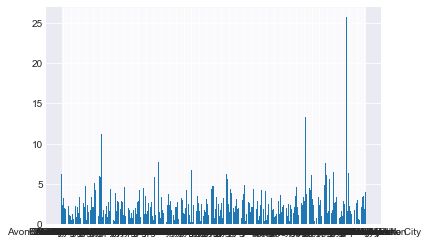

In [136]:
KnifePerson = WardPopAnn['Knife_Person']
Wards = WardPopAnn['Ward Name']
plt.bar(Wards, KnifePerson)
plt.show()

In [128]:
WardAnnCodes = WardAnnual['Ward Code'].unique()
WardProfCodes = WardProf['Ward Code'].unique()

set(WardAnnCodes) == set(WardProfCodes)

False

In [117]:
WardPopAnn.to_csv("Ward_KnifePerson.csv")